## Segmenting each label


Processing Training dataset...

Processing category: no_tumor
Found 395 LAB images for segmentation in no_tumor


Segmenting no_tumor images: 100%|██████████| 395/395 [02:26<00:00,  2.69it/s]



Visualizing sample results for no_tumor:


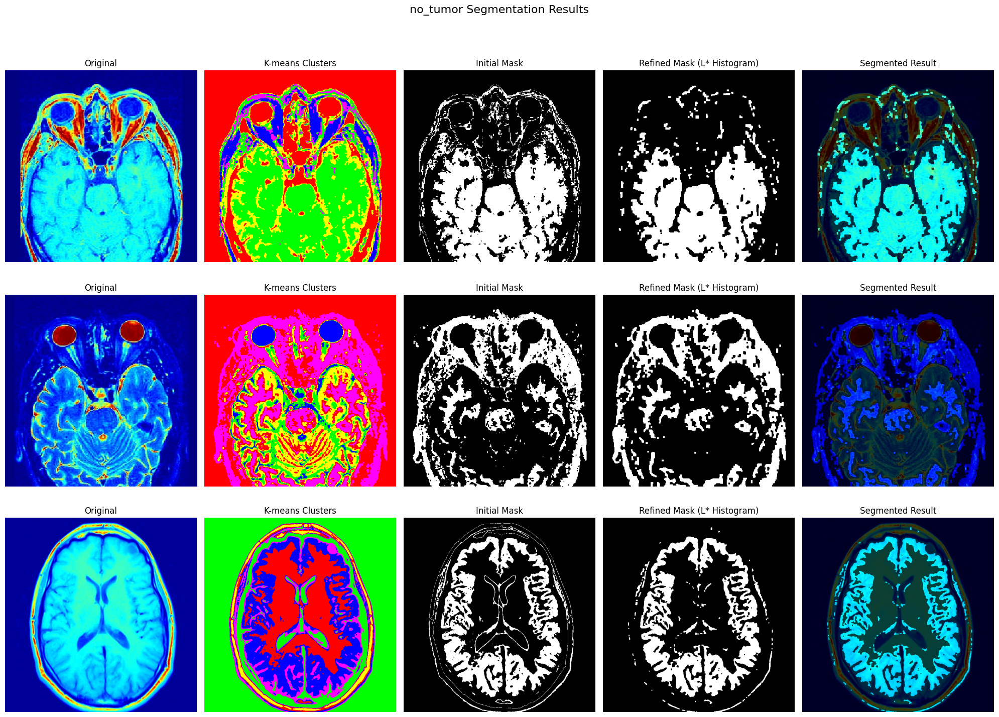


Processing category: meningioma_tumor
Found 822 LAB images for segmentation in meningioma_tumor


Segmenting meningioma_tumor images: 100%|██████████| 822/822 [05:06<00:00,  2.68it/s]



Visualizing sample results for meningioma_tumor:


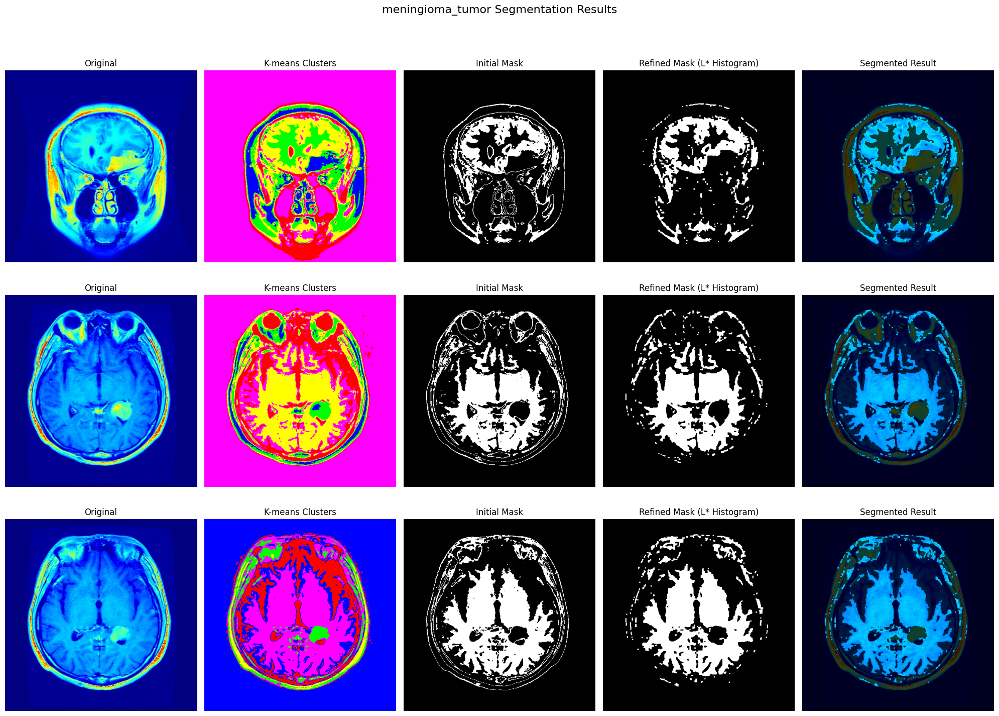


Processing category: glioma_tumor
Found 826 LAB images for segmentation in glioma_tumor


Segmenting glioma_tumor images: 100%|██████████| 826/826 [07:40<00:00,  1.79it/s]



Visualizing sample results for glioma_tumor:


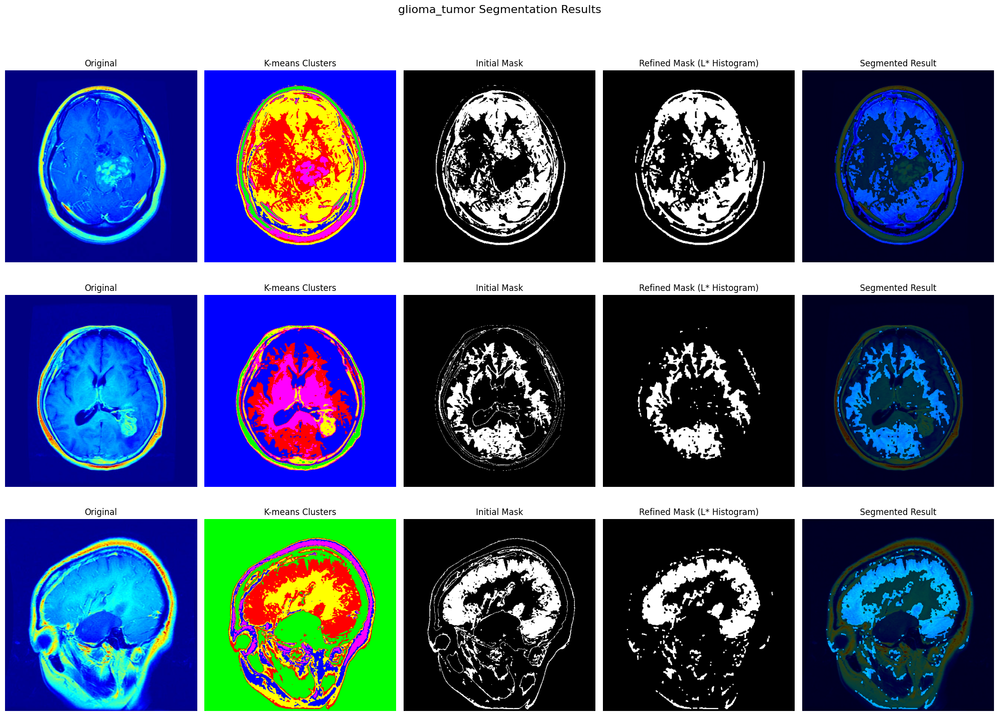


Processing category: pituitary_tumor
Found 827 LAB images for segmentation in pituitary_tumor


Segmenting pituitary_tumor images: 100%|██████████| 827/827 [08:01<00:00,  1.72it/s]



Visualizing sample results for pituitary_tumor:


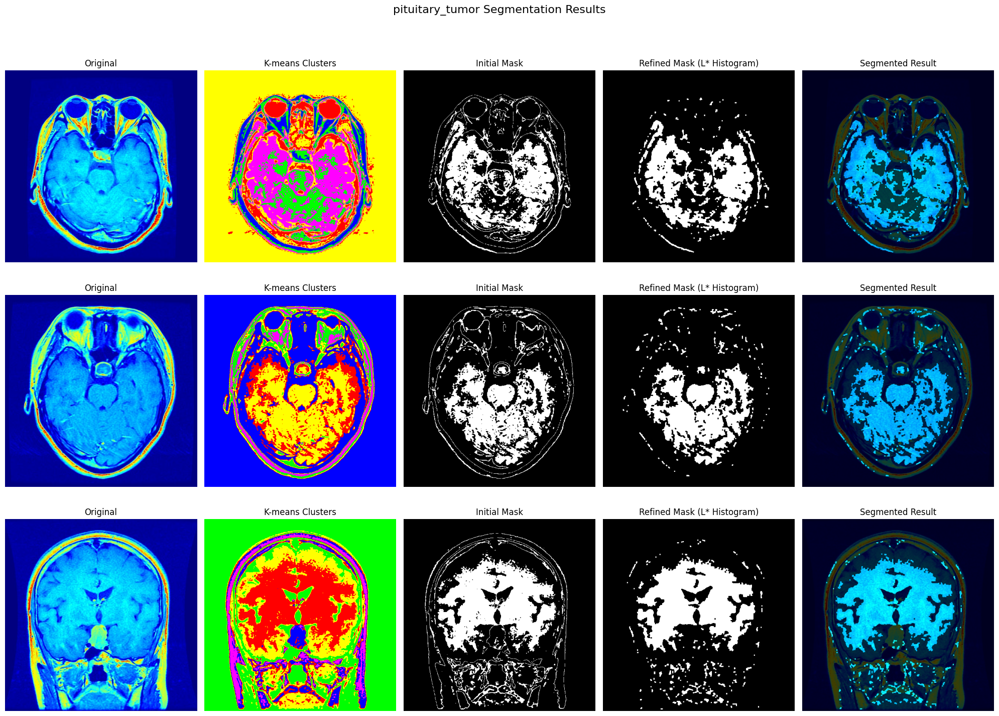


Processing Testing dataset...

Processing category: no_tumor
Found 105 LAB images for segmentation in no_tumor


Segmenting no_tumor images: 100%|██████████| 105/105 [00:20<00:00,  5.02it/s]



Visualizing sample results for no_tumor:


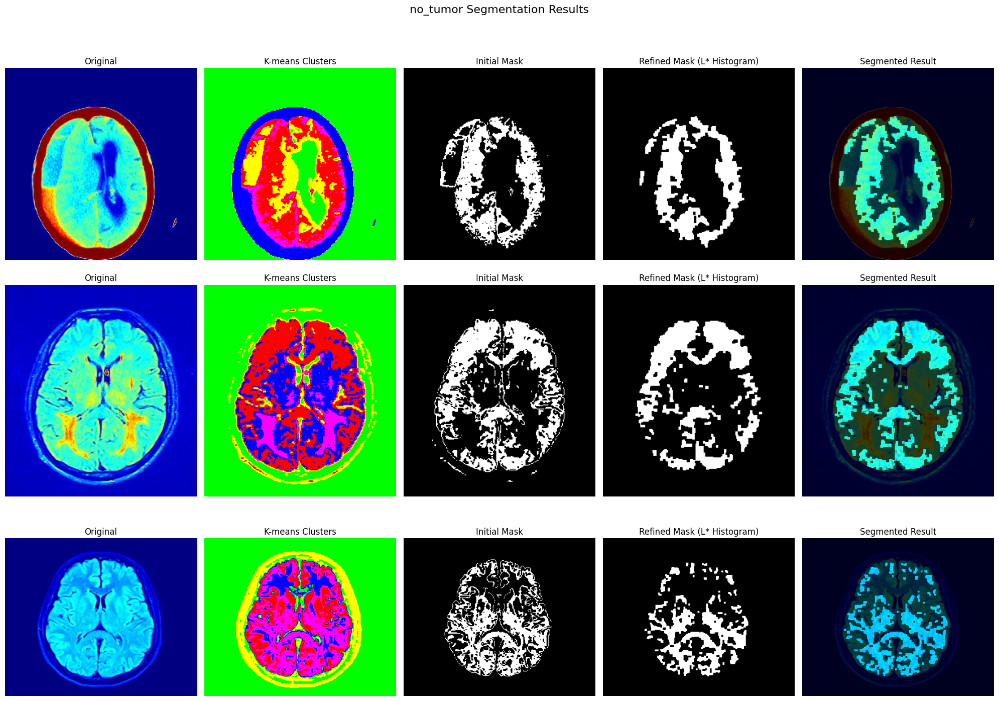


Processing category: meningioma_tumor
Found 115 LAB images for segmentation in meningioma_tumor


Segmenting meningioma_tumor images: 100%|██████████| 115/115 [00:33<00:00,  3.40it/s]



Visualizing sample results for meningioma_tumor:


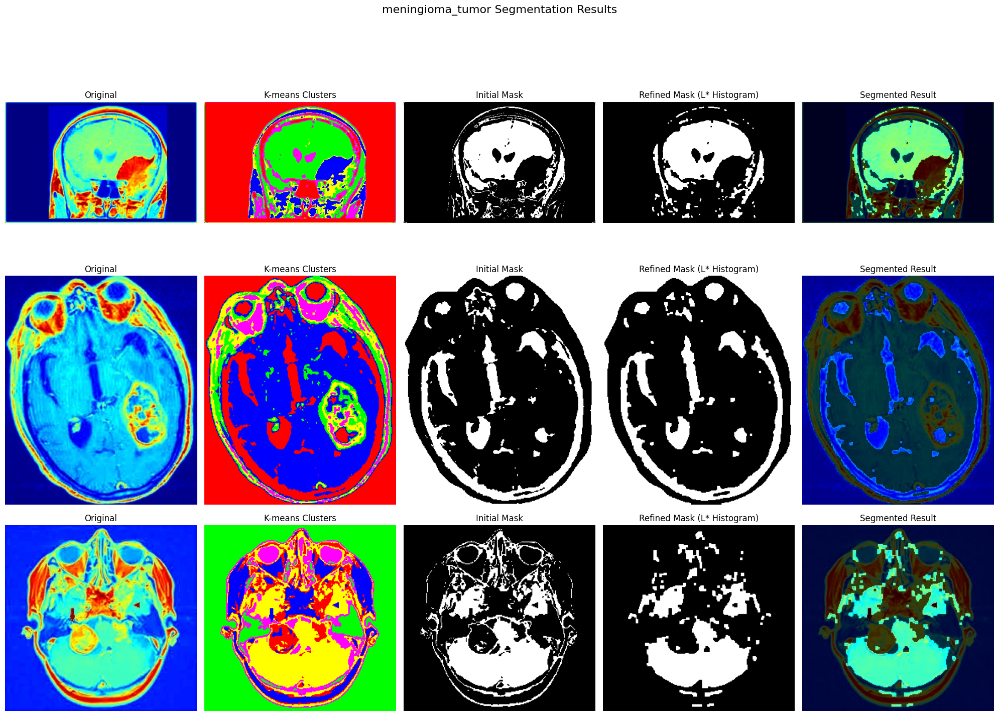


Processing category: glioma_tumor
Found 100 LAB images for segmentation in glioma_tumor


Segmenting glioma_tumor images: 100%|██████████| 100/100 [00:42<00:00,  2.35it/s]



Visualizing sample results for glioma_tumor:


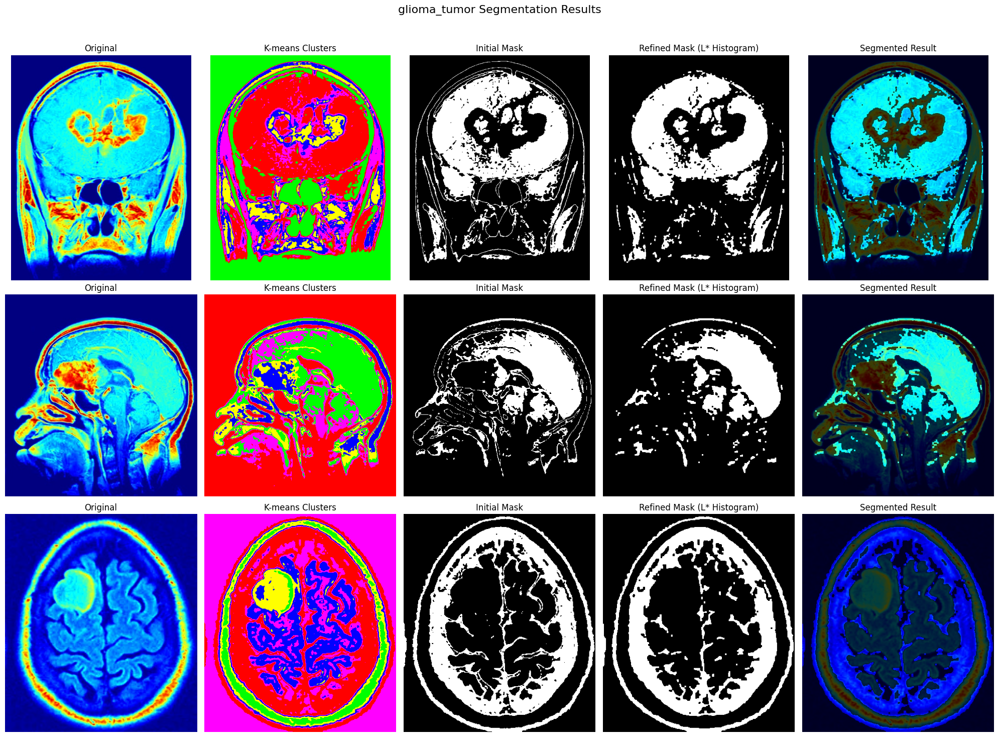


Processing category: pituitary_tumor
Found 74 LAB images for segmentation in pituitary_tumor


Segmenting pituitary_tumor images: 100%|██████████| 74/74 [00:59<00:00,  1.24it/s]



Visualizing sample results for pituitary_tumor:


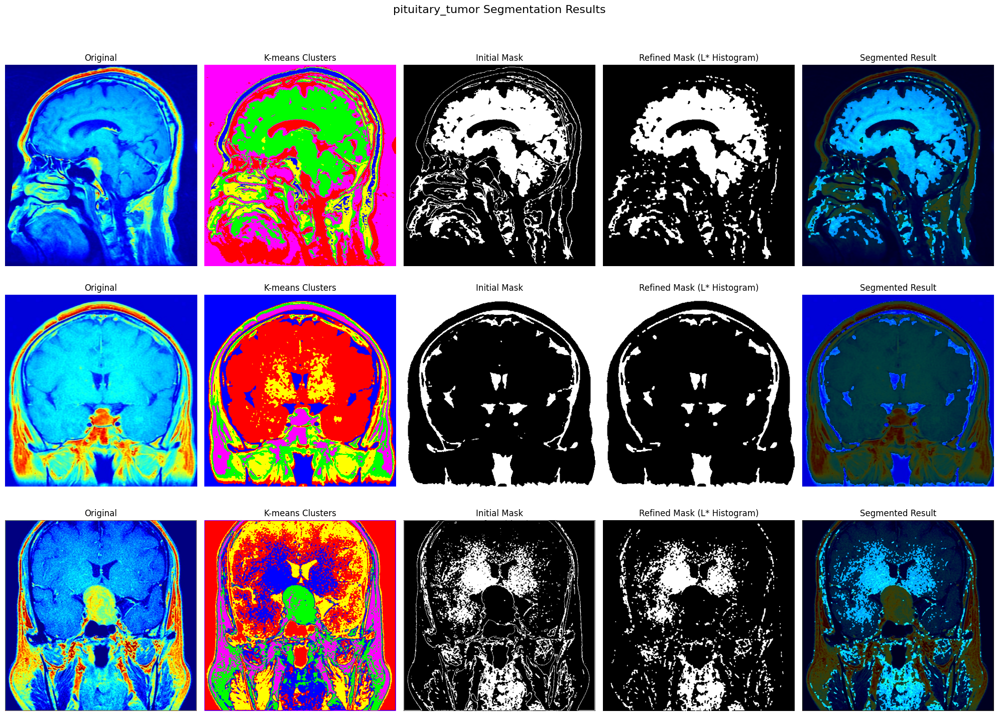


Segmentation complete!

Comparing segmentation results across tumor categories...


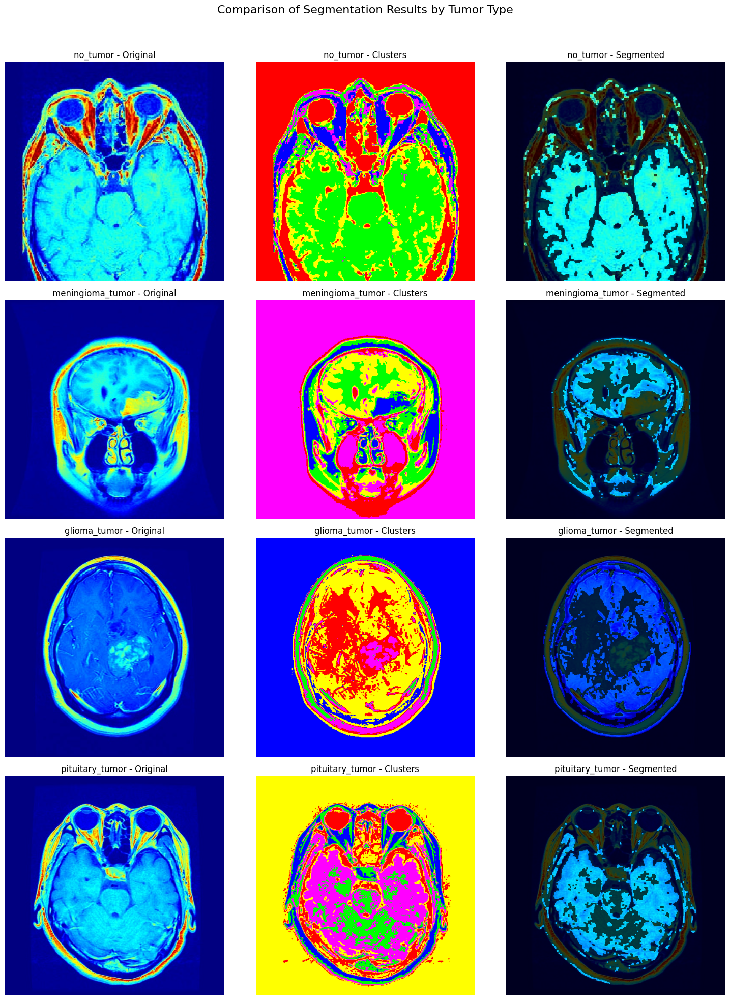


Analyzing characteristics of segmented regions by tumor type...


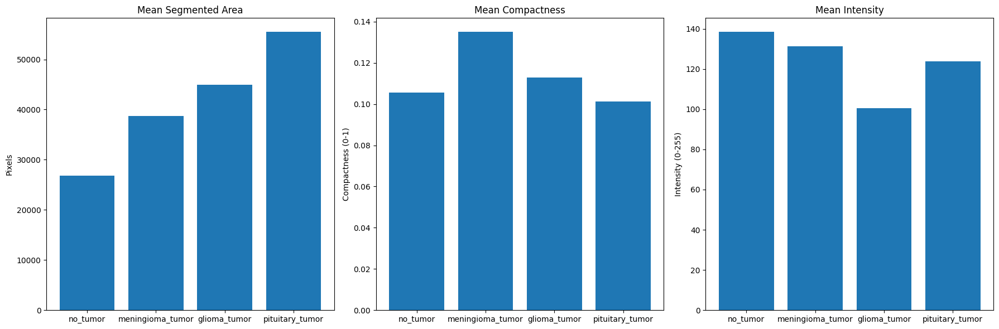

In [8]:
import os
import numpy as np
import cv2
from skimage import color
from matplotlib import pyplot as plt
from tqdm import tqdm
from sklearn.cluster import KMeans
import matplotlib.gridspec as gridspec

def segment_colorized_images_by_category(input_dir, output_dir, categories, n_clusters=5, visualize=True):
    """
    Segment colorized MRI images by tumor categories using K-means clustering in a*b* space and L* histogram clustering
    
    Parameters:
    -----------
    input_dir : str
        Directory containing the colorized MRI images (with _lab suffix)
    output_dir : str
        Directory to save the segmented images
    categories : list
        List of tumor categories (folder names) to process
    n_clusters : int
        Number of clusters for K-means
    visualize : bool
        Whether to visualize sample results for each category
    """
    
    # Create output directory if it doesn't exist
    if not os.path.exists(output_dir):
        os.makedirs(output_dir)
    
    all_results = {}  # Store results for visualization, organized by category
    
    # Process each category
    for category in categories:
        category_input_dir = os.path.join(input_dir, category)
        category_output_dir = os.path.join(output_dir, category)
        
        if not os.path.exists(category_input_dir):
            print(f"Category directory not found: {category_input_dir}")
            continue
            
        if not os.path.exists(category_output_dir):
            os.makedirs(category_output_dir)
        
        print(f"\nProcessing category: {category}")
        
        # Get all LAB images for this category
        image_files = []
        for root, _, files in os.walk(category_input_dir):
            for file in files:
                if file.lower().endswith('_lab.png') or file.lower().endswith('_lab.jpg'):
                    image_files.append(os.path.join(root, file))
        
        print(f"Found {len(image_files)} LAB images for segmentation in {category}")
        
        category_results = []  # Store results for this category
        
        # Process each image in this category
        for img_path in tqdm(image_files, desc=f"Segmenting {category} images"):
            # Extract base path for saving outputs
            rel_path = os.path.relpath(img_path, category_input_dir)
            base_output_path = os.path.join(category_output_dir, os.path.basename(img_path).rsplit('_lab.', 1)[0])
            
            # Create subdirectories if needed
            os.makedirs(os.path.dirname(os.path.join(category_output_dir, rel_path)), exist_ok=True)
            
            # Read LAB image components
            # We'll read the separate L, a, b components if available
            try:
                l_path = img_path.replace('_lab.', '_l.')
                a_path = img_path.replace('_lab.', '_a.')
                b_path = img_path.replace('_lab.', '_b.')
                
                if os.path.exists(l_path) and os.path.exists(a_path) and os.path.exists(b_path):
                    # Read separate components
                    l_channel = cv2.imread(l_path, cv2.IMREAD_GRAYSCALE)
                    a_channel = cv2.imread(a_path, cv2.IMREAD_GRAYSCALE)
                    b_channel = cv2.imread(b_path, cv2.IMREAD_GRAYSCALE)
                    
                    # Convert back to LAB range
                    l_norm = l_channel * 100 / 255  # L: [0, 100]
                    a_norm = a_channel.astype(float) - 128  # a: [-128, 127]
                    b_norm = b_channel.astype(float) - 128  # b: [-128, 127]
                    
                    # Create LAB image
                    lab_img = np.zeros((l_channel.shape[0], l_channel.shape[1], 3))
                    lab_img[:,:,0] = l_norm
                    lab_img[:,:,1] = a_norm
                    lab_img[:,:,2] = b_norm
                else:
                    # Read the LAB image directly
                    lab_8bit = cv2.imread(img_path)
                    
                    if lab_8bit is None:
                        print(f"Warning: Could not read {img_path}")
                        continue
                    
                    # Convert from 8-bit representation to LAB range
                    lab_img = np.zeros_like(lab_8bit, dtype=float)
                    lab_img[:,:,0] = lab_8bit[:,:,0] * 100 / 255  # L: [0, 100]
                    lab_img[:,:,1] = lab_8bit[:,:,1].astype(float) - 128  # a: [-128, 127]
                    lab_img[:,:,2] = lab_8bit[:,:,2].astype(float) - 128  # b: [-128, 127]
            except Exception as e:
                print(f"Error processing {img_path}: {e}")
                continue
            
            # Also read the RGB version for visualization
            rgb_path = img_path.replace('_lab.', '_rgb.')
            if os.path.exists(rgb_path):
                rgb_img = cv2.imread(rgb_path)
                rgb_img = cv2.cvtColor(rgb_img, cv2.COLOR_BGR2RGB)
            else:
                # Convert LAB to RGB for visualization
                lab_8bit = np.zeros_like(lab_img, dtype=np.uint8)
                lab_8bit[:,:,0] = np.uint8(lab_img[:,:,0] * 255 / 100)
                lab_8bit[:,:,1] = np.uint8(lab_img[:,:,1] + 128)
                lab_8bit[:,:,2] = np.uint8(lab_img[:,:,2] + 128)
                rgb_img = cv2.cvtColor(lab_8bit, cv2.COLOR_LAB2RGB)
            
            # Reshape a*b* components for K-means clustering
            h, w, _ = lab_img.shape
            ab_components = lab_img[:,:,1:3].reshape(h*w, 2)
            
            # Apply K-means clustering
            kmeans = KMeans(n_clusters=n_clusters, random_state=42)
            cluster_labels = kmeans.fit_predict(ab_components)
            
            # Reshape cluster labels to image dimensions
            segmented = cluster_labels.reshape(h, w)
            
            # Generate an image where each cluster has a different color
            colored_segments = np.zeros((h, w, 3), dtype=np.uint8)
            
            # Define colors for each cluster
            colors = [
                [255, 0, 0],    # Red
                [0, 255, 0],    # Green
                [0, 0, 255],    # Blue
                [255, 255, 0],  # Yellow
                [255, 0, 255],  # Magenta
                [0, 255, 255],  # Cyan
                [128, 0, 0],    # Maroon
                [0, 128, 0],    # Green
                [0, 0, 128],    # Navy
                [128, 128, 0]   # Olive
            ]
            
            for i in range(n_clusters):
                colored_segments[segmented == i] = colors[i % len(colors)]
            
            # Save segmented image
            cv2.imwrite(f"{base_output_path}_segmented.png", cv2.cvtColor(colored_segments, cv2.COLOR_RGB2BGR))
            
            # Calculate cluster sizes
            cluster_sizes = [np.sum(segmented == i) for i in range(n_clusters)]
            
            # Special handling for no_tumor vs tumor categories
            if category.lower() == 'notumor':
                # For no tumor, focus on the most distinct cluster (often the smallest significant one)
                # Skip very small clusters (likely noise)
                significant_clusters = [i for i, size in enumerate(cluster_sizes) if size > (h*w*0.02)]  # At least 2% of image
                if significant_clusters:
                    # Find the cluster with center most different from mean of all pixels
                    ab_mean = np.mean(ab_components, axis=0)
                    distances = [np.linalg.norm(kmeans.cluster_centers_[i] - ab_mean) for i in significant_clusters]
                    target_cluster = significant_clusters[np.argmax(distances)]
                else:
                    # Fallback to second largest
                    sorted_clusters = np.argsort(cluster_sizes)[::-1]
                    target_cluster = sorted_clusters[1] if len(sorted_clusters) > 1 else sorted_clusters[0]
            else:
                # For tumor categories, usually the second largest cluster corresponds to the tumor
                # (first largest is often the background)
                sorted_clusters = np.argsort(cluster_sizes)[::-1]
                target_cluster = sorted_clusters[1] if len(sorted_clusters) > 1 else sorted_clusters[0]
            
            # Create binary mask for the target cluster
            initial_mask = (segmented == target_cluster).astype(np.uint8) * 255
            
            # Save initial mask
            cv2.imwrite(f"{base_output_path}_initial_mask.png", initial_mask)
            
            # Further refine with L* histogram clustering
            l_values = lab_img[:,:,0][segmented == target_cluster]
            
            if len(l_values) > 0:
                # Use a simplified approach: threshold on L* values
                # Create histogram of L* values in target cluster
                hist, bins = np.histogram(l_values, bins=10, range=(0, 100))
                
                # Find the bin with most pixels
                peak_bin = np.argmax(hist)
                
                # Set threshold around this peak
                l_min = bins[max(0, peak_bin - 1)]
                l_max = bins[min(len(bins)-1, peak_bin + 2)]
                
                # Create refined mask
                refined_mask = np.zeros_like(initial_mask)
                l_channel = lab_img[:,:,0]
                mask_condition = (segmented == target_cluster) & (l_channel >= l_min) & (l_channel <= l_max)
                refined_mask[mask_condition] = 255
                
                # Optional: Apply morphological operations to clean the mask
                kernel = np.ones((3, 3), np.uint8)
                refined_mask = cv2.morphologyEx(refined_mask, cv2.MORPH_OPEN, kernel)
                refined_mask = cv2.morphologyEx(refined_mask, cv2.MORPH_CLOSE, kernel)
                
                # Save refined mask
                cv2.imwrite(f"{base_output_path}_refined_mask.png", refined_mask)
                
                # Apply mask to original image
                segmented_result = rgb_img.copy()
                for c in range(3):
                    segmented_result[:,:,c] = np.where(refined_mask == 255, 
                                                      rgb_img[:,:,c], 
                                                      rgb_img[:,:,c] // 4)  # Darken non-segmented regions
                
                # Save segmented result
                cv2.imwrite(f"{base_output_path}_segmented_result.png", cv2.cvtColor(segmented_result, cv2.COLOR_RGB2BGR))
                
                # Store result for visualization
                category_results.append({
                    'path': img_path,
                    'original': rgb_img,
                    'clusters': colored_segments,
                    'initial_mask': initial_mask,
                    'refined_mask': refined_mask,
                    'segmented_result': segmented_result
                })
        
        # Store results for this category
        all_results[category] = category_results
        
        # Visualize results for this category
        if visualize and category_results:
            # Choose a subset of results to visualize
            num_to_show = min(3, len(category_results))
            selected_results = category_results[:num_to_show]
            
            print(f"\nVisualizing sample results for {category}:")
            visualize_segmentation_results(selected_results, title=f"{category} Segmentation Results")
    
    return all_results

def visualize_segmentation_results(results, title="Segmentation Results"):
    """
    Visualize segmentation results
    """
    n_samples = len(results)
    fig = plt.figure(figsize=(20, 5 * n_samples))
    gs = gridspec.GridSpec(n_samples, 5, figure=fig)
    
    fig.suptitle(title, fontsize=16)
    
    for i, result in enumerate(results):
        # Original image
        ax = fig.add_subplot(gs[i, 0])
        ax.imshow(result['original'])
        ax.set_title("Original")
        ax.axis('off')
        
        # K-means clusters
        ax = fig.add_subplot(gs[i, 1])
        ax.imshow(result['clusters'])
        ax.set_title("K-means Clusters")
        ax.axis('off')
        
        # Initial mask
        ax = fig.add_subplot(gs[i, 2])
        ax.imshow(result['initial_mask'], cmap='gray')
        ax.set_title("Initial Mask")
        ax.axis('off')
        
        # Refined mask
        ax = fig.add_subplot(gs[i, 3])
        ax.imshow(result['refined_mask'], cmap='gray')
        ax.set_title("Refined Mask (L* Histogram)")
        ax.axis('off')
        
        # Final segmented result
        ax = fig.add_subplot(gs[i, 4])
        ax.imshow(result['segmented_result'])
        ax.set_title("Segmented Result")
        ax.axis('off')
    
    plt.tight_layout(rect=[0, 0, 1, 0.96])  # Adjust for the suptitle
    plt.show()

def compare_categories(all_results, categories):
    """
    Compare segmentation results across different tumor categories
    """
    # Select one sample from each category
    samples = {}
    for category in categories:
        if category in all_results and all_results[category]:
            samples[category] = all_results[category][0]
    
    if len(samples) < 2:
        print("Not enough categories with results for comparison")
        return
    
    # Visualize comparison
    fig, axes = plt.subplots(len(samples), 3, figsize=(15, 5 * len(samples)))
    fig.suptitle("Comparison of Segmentation Results by Tumor Type", fontsize=16)
    
    for i, (category, result) in enumerate(samples.items()):
        # Original
        axes[i, 0].imshow(result['original'])
        axes[i, 0].set_title(f"{category} - Original")
        axes[i, 0].axis('off')
        
        # K-means clusters
        axes[i, 1].imshow(result['clusters'])
        axes[i, 1].set_title(f"{category} - Clusters")
        axes[i, 1].axis('off')
        
        # Segmented result
        axes[i, 2].imshow(result['segmented_result'])
        axes[i, 2].set_title(f"{category} - Segmented")
        axes[i, 2].axis('off')
    
    plt.tight_layout(rect=[0, 0, 1, 0.96])  # Adjust for the suptitle
    plt.show()

def analyze_cluster_characteristics(all_results, categories):
    """
    Analyze and compare characteristics of the segmented regions across categories
    """
    category_stats = {}
    
    for category in categories:
        if category not in all_results or not all_results[category]:
            continue
            
        # Collect statistics for this category
        areas = []
        compactness = []
        intensity = []
        
        for result in all_results[category]:
            # Use refined mask for analysis
            mask = result['refined_mask']
            
            # Calculate area (number of white pixels)
            area = np.sum(mask > 0)
            areas.append(area)
            
            # Calculate compactness (ratio of area to perimeter squared)
            # Find contours
            contours, _ = cv2.findContours(mask, cv2.RETR_EXTERNAL, cv2.CHAIN_APPROX_SIMPLE)
            if contours:
                main_contour = max(contours, key=cv2.contourArea)
                perimeter = cv2.arcLength(main_contour, True)
                if perimeter > 0:
                    comp = (4 * np.pi * cv2.contourArea(main_contour)) / (perimeter ** 2)
                    compactness.append(comp)
            
            # Calculate average intensity in the segmented region
            original = result['original']
            # Convert to grayscale for intensity analysis
            gray = cv2.cvtColor(original, cv2.COLOR_RGB2GRAY)
            # Calculate mean intensity in the mask region
            masked_intensity = cv2.mean(gray, mask=mask)[0]
            intensity.append(masked_intensity)
        
        # Store statistics
        category_stats[category] = {
            'areas': areas,
            'compactness': compactness,
            'intensity': intensity,
            'mean_area': np.mean(areas) if areas else 0,
            'mean_compactness': np.mean(compactness) if compactness else 0,
            'mean_intensity': np.mean(intensity) if intensity else 0
        }
    
    # Visualize statistics
    if category_stats:
        # Plot mean values for each category
        fig, axes = plt.subplots(1, 3, figsize=(18, 6))
        
        # Categories to plot
        plot_categories = list(category_stats.keys())
        
        # Plot mean areas
        areas = [category_stats[cat]['mean_area'] for cat in plot_categories]
        axes[0].bar(plot_categories, areas)
        axes[0].set_title('Mean Segmented Area')
        axes[0].set_ylabel('Pixels')
        
        # Plot mean compactness
        compactness = [category_stats[cat]['mean_compactness'] for cat in plot_categories]
        axes[1].bar(plot_categories, compactness)
        axes[1].set_title('Mean Compactness')
        axes[1].set_ylabel('Compactness (0-1)')
        
        # Plot mean intensity
        intensity = [category_stats[cat]['mean_intensity'] for cat in plot_categories]
        axes[2].bar(plot_categories, intensity)
        axes[2].set_title('Mean Intensity')
        axes[2].set_ylabel('Intensity (0-255)')
        
        plt.tight_layout()
        plt.show()
    
    return category_stats

def main():
    # Paths
    colorized_dir = "E:\College\Sem 6\Machine Vision\Project\colorized_mri_dataset"  # Directory containing your colorized images
    output_dir = "segmented_mri_dataset"     # Directory to save segmentation results
    
    # Tumor categories
    categories = ["no_tumor", "meningioma_tumor", "glioma_tumor", "pituitary_tumor"]
    
    # Process Training data
    print("\nProcessing Training dataset...")
    train_dir = os.path.join(colorized_dir, "Training")
    train_output_dir = os.path.join(output_dir, "Training")
    train_results = segment_colorized_images_by_category(
        train_dir, 
        train_output_dir, 
        categories, 
        n_clusters=5, 
        visualize=True
    )
    
    # Process Testing data
    print("\nProcessing Testing dataset...")
    test_dir = os.path.join(colorized_dir, "Testing")
    test_output_dir = os.path.join(output_dir, "Testing")
    test_results = segment_colorized_images_by_category(
        test_dir, 
        test_output_dir, 
        categories, 
        n_clusters=5, 
        visualize=True
    )
    
    print("\nSegmentation complete!")
    
    # Compare results across categories
    print("\nComparing segmentation results across tumor categories...")
    compare_categories(train_results, categories)
    
    # Analyze cluster characteristics
    print("\nAnalyzing characteristics of segmented regions by tumor type...")
    category_stats = analyze_cluster_characteristics(train_results, categories)
    
    # Optional: Find optimal cluster number for each category
    #print("\nFinding optimal cluster numbers for each category...")
    #find_optimal_clusters_by_category(train_dir, categories)

def find_optimal_clusters_by_category(input_dir, categories):
    """
    Experiment with different numbers of clusters for each category
    """
    # Cluster numbers to try
    cluster_numbers = [3, 5, 7, 9]
    
    for category in categories:
        category_input_dir = os.path.join(input_dir, category)
        
        if not os.path.exists(category_input_dir):
            print(f"Category directory not found: {category_input_dir}")
            continue
        
        # Find a sample image
        sample_path = None
        for root, _, files in os.walk(category_input_dir):
            for file in files:
                if file.lower().endswith('_lab.png') or file.lower().endswith('_lab.jpg'):
                    sample_path = os.path.join(root, file)
                    break
            if sample_path:
                break
        
        if not sample_path:
            print(f"No sample images found for category: {category}")
            continue
        
        print(f"\nExperimenting with different cluster numbers for {category}...")
        experiment_with_cluster_numbers(sample_path, cluster_numbers, category=category)

def experiment_with_cluster_numbers(sample_path, cluster_numbers, category=None):
    """
    Experiment with different numbers of clusters on a sample image
    """
    # Read LAB image
    lab_8bit = cv2.imread(sample_path)
    
    if lab_8bit is None:
        print(f"Warning: Could not read {sample_path}")
        return
    
    # Convert from 8-bit representation to LAB range
    lab_img = np.zeros_like(lab_8bit, dtype=float)
    lab_img[:,:,0] = lab_8bit[:,:,0] * 100 / 255  # L: [0, 100]
    lab_img[:,:,1] = lab_8bit[:,:,1].astype(float) - 128  # a: [-128, 127]
    lab_img[:,:,2] = lab_8bit[:,:,2].astype(float) - 128  # b: [-128, 127]
    
    # Also read the RGB version for visualization
    rgb_path = sample_path.replace('_lab.', '_rgb.')
    if os.path.exists(rgb_path):
        rgb_img = cv2.imread(rgb_path)
        rgb_img = cv2.cvtColor(rgb_img, cv2.COLOR_BGR2RGB)
    else:
        # Convert LAB to RGB for visualization
        lab_to_rgb = np.zeros_like(lab_img, dtype=np.uint8)
        lab_to_rgb[:,:,0] = np.uint8(lab_img[:,:,0] * 255 / 100)
        lab_to_rgb[:,:,1] = np.uint8(lab_img[:,:,1] + 128)
        lab_to_rgb[:,:,2] = np.uint8(lab_img[:,:,2] + 128)
        rgb_img = cv2.cvtColor(lab_to_rgb, cv2.COLOR_LAB2RGB)
    
    # Reshape a*b* components for K-means clustering
    h, w, _ = lab_img.shape
    ab_components = lab_img[:,:,1:3].reshape(h*w, 2)
    
    # Set up figure
    fig, axes = plt.subplots(1, len(cluster_numbers) + 1, figsize=(5 * (len(cluster_numbers) + 1), 5))
    title = f"Cluster Number Comparison for {category}" if category else "Cluster Number Comparison"
    fig.suptitle(title, fontsize=16)
    
    # Original image
    axes[0].imshow(rgb_img)
    axes[0].set_title("Original")
    axes[0].axis('off')
    
    # Define colors for clusters
    colors = [
        [255, 0, 0],    # Red
        [0, 255, 0],    # Green
        [0, 0, 255],    # Blue
        [255, 255, 0],  # Yellow
        [255, 0, 255],  # Magenta
        [0, 255, 255],  # Cyan
        [128, 0, 0],    # Maroon
        [0, 128, 0],    # Green
        [0, 0, 128],    # Navy
        [128, 128, 0],  # Olive
        [128, 0, 128],  # Purple
        [0, 128, 128],  # Teal
        [192, 192, 192] # Silver
    ]
    
    # Try different numbers of clusters
    for i, n_clusters in enumerate(cluster_numbers):
        # Apply K-means clustering
        kmeans = KMeans(n_clusters=n_clusters, random_state=42)
        cluster_labels = kmeans.fit_predict(ab_components)
        
        # Reshape cluster labels to image dimensions
        segmented = cluster_labels.reshape(h, w)
        
        # Generate an image where each cluster has a different color
        colored_segments = np.zeros((h, w, 3), dtype=np.uint8)
        
        for j in range(n_clusters):
            colored_segments[segmented == j] = colors[j % len(colors)]
        
        # Display result
        axes[i+1].imshow(colored_segments)
        axes[i+1].set_title(f"{n_clusters} Clusters")
        axes[i+1].axis('off')
    
    plt.tight_layout(rect=[0, 0, 1, 0.96])  # Adjust for the suptitle
    plt.show()

if __name__ == "__main__":
    main()